# Seismology and Isostasy

IN THE SPACE BELOW, WRITE OUT IN FULL AND THEN SIGN THE HONOR PLEDGE:

“I pledge my honor that I have not violated the honor code during this examination.”

**PRINT NAME**: 

If a fellow student has contributed significantly to this work, please acknowledge them here:

**Peer(s)**:                          

*Contribution:*


By uploading this assignment through Canvas, I sign off on the document below electronically.

----

## Downloads from the Internet 

We will need some files from the internet that will be used in this assignment. If you get errors in the following cell block, it probably means the machine (or the node in a cluster) you are calling this command from does not have direct internet access.

**Note**: If you are on the Adroit cluster in Princeton, please make sure you are within a *Jupyter on Adroit Vis* session since this node has internet access. You can use any other session for the remaining cells in this notebook; *Jupyter for classes* is suggested since a dedicated class environment (GEO203) with all necessary modules has been created for this course.

In [1]:
import os
import requests
from pathlib import Path

# Define the list of remote files to retrieve\n",
remote_url = 'https://portal.globalseismology.org/files/DATA/GLOBALTOPO/ETOPO1_Ice_g_gmt4.grd'

path = '../PS_Plate_Tectonics/Files/'
# Define the local filename to save data
local_file = path + os.path.basename(remote_url)

In [2]:
if not Path(local_file).is_file():
    # mke the directory if it does not exist
    if not os.path.isdir(path): os.makedirs(path)

    # Download remote and save locally
    r = requests.get(remote_url, allow_redirects=True)
    open(local_file, 'wb').write(r.content)

## Part I: Mountain building and isostasy

Mountain ranges are created at present subduction zones (for the Andes or the Himalayas) or past subduction zones (for the Appalachians). These are regions where the lithosphere is thickening due to the compressional stress, crustal thickening and volcanism, facilitated by the relatively lower strength of the lower crust (i.e. think of strength envelopes of continental crust).

<img src = "Images/Subduction_Zone.gif" width = "70%" >

*Figure: Anatomy of a subduction zone setting. Source: [USGS](https://www.usgs.gov/news/science-snippet/earthword-subduction)*

In the schematic above, note that the continental crust at the mountain belt is thickened not only upward but also downward into the mantle asthenosphere. Mountain building causes *relief*, the elevation difference between peaks and adjoining areas which may already be above sea level. 

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


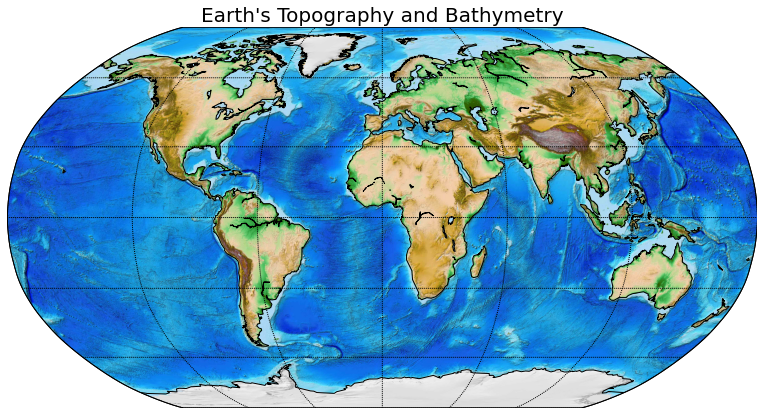

In [3]:
import os
os.environ['PROJ_LIB'] = os.path.join(os.environ['CONDA_PREFIX'],'share/proj') # This is required for Basemap plotting to work

from mpl_toolkits.basemap import Basemap
import numpy as np
import matplotlib.pyplot as plt

fig = plt.figure(figsize=[14, 7])
# lon_0 is central longitude of projection.
# resolution = 'c' means use crude resolution coastlines.
m = Basemap(projection='robin',lon_0=0,resolution='c')
m.drawcoastlines()
# draw parallels and meridians.
m.drawparallels(np.arange(-90.,90.,30.))
m.drawmeridians(np.arange(-180.,180.,60.))
m.drawmapboundary()
m.etopo()
plt.title("Earth's Topography and Bathymetry",fontsize=20)
plt.show()

Let us first explore surface topography from the [ETOPO1 model] and focus on the Andes mountain range in South America. We will make a cross-section that cuts through the mountain range so that we may calculate the *local refief*.

In [4]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import plotly
plotly.offline.init_notebook_mode() 

In [5]:
# Read ETOPO1 topography data file
ds = xr.open_dataset('../PS_Plate_Tectonics/Files/ETOPO1_Ice_g_gmt4.grd')

# Display the content
ds

<xarray.Dataset>
Dimensions:  (x: 21601, y: 10801)
Coordinates:
  * x        (x) float64 -180.0 -180.0 -180.0 -179.9 ... 179.9 180.0 180.0 180.0
  * y        (y) float64 -90.0 -89.98 -89.97 -89.95 ... 89.95 89.97 89.98 90.0
Data variables:
    z        (y, x) float64 ...
Attributes:
    Conventions:  COARDS/CF-1.0
    title:        ETOPO1_Ice_g_gmt4.grd
    GMT_version:  4.4.0
    node_offset:  0

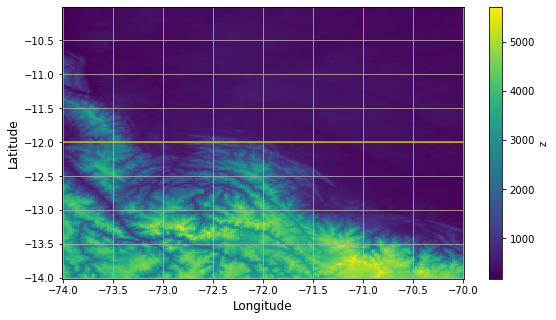

In [6]:
# Plotting the topographic map of the Andes
# WARNING: Plotting the entire Earth may cause the kernel to die

min_longitude = -74       # left-boarder of the map
max_longitude = -70       # right-boarder of the map
min_latitude  = -14       # lower-boarder of the map
max_latitude  = -10       # upper-boarder of the map

cross_section_latitude = -12    # for the cross-section plot
fig = plt.figure(figsize=[9,5])
obj = ds.z.sel(x=slice(min_longitude, max_longitude),y=slice(min_latitude, max_latitude)).plot()
# a line representing the cross-section in the next figure
plt.plot([min_longitude, max_longitude], [cross_section_latitude, cross_section_latitude], 'y')
plt.xlabel('Longitude', fontsize=12)
plt.ylabel('Latitude', fontsize=12)
plt.grid()

/opt/export/course/geo203/anaconda3/envs/fall2022/lib/python3.9/site-packages/xarray/core/indexes.py:234: FutureWarning:

Passing method to Float64Index.get_loc is deprecated and will raise in a future version. Use index.get_indexer([item], method=...) instead.



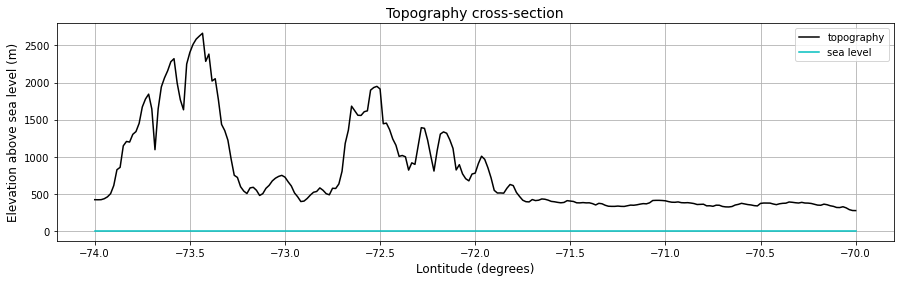

In [7]:
# Plotting a cross-section
plt.figure(figsize=[15,4])
ds_slice = ds.sel(y=cross_section_latitude, method="nearest").sel(x=slice(min_longitude, max_longitude))
plt.plot(ds_slice['x'], ds_slice['z'], 'k', label='topography')
plt.plot([min(ds_slice['x']), max(ds_slice['x'])], [0, 0], 'c', label='sea level')
plt.grid()
plt.xlabel('Lontitude (degrees)', fontsize = 12)
plt.ylabel('Elevation above sea level (m)', fontsize = 12)
plt.title('Topography cross-section', fontsize=14)
plt.legend()
plt.show()

It is difficult to read values of local relief from a static curve like the one above. We will make an interactive plot below:

In [8]:
ds_region = ds.sel(x=slice(min_longitude, max_longitude),y=slice(min_latitude, max_latitude))

x = np.array(ds_region['x'])
y = np.array(ds_region['y'])
z = np.array(ds_region['z'])
x, y = np.meshgrid(x, y)

# Colorscale for mount plot:
pl_gist_earth=[[0.0, 'rgb(0,0,0)'],
               [0.05, 'rgb(7,11,116)'],
               [0.1, 'rgb(16,41,119)'],
               [0.15, 'rgb(25,69,121)'],
               [0.2, 'rgb(33,94,123)'],
               [0.25, 'rgb(42,115,126)'],
               [0.3, 'rgb(49,130,122)'],
               [0.35, 'rgb(56,137,106)'],
               [0.4, 'rgb(62,145,90)'],
               [0.45, 'rgb(68,152,74)'],
               [0.5, 'rgb(93,160,75)'],
               [0.55, 'rgb(120,166,82)'],
               [0.6, 'rgb(141,171,86)'],
               [0.65, 'rgb(163,177,90)'],
               [0.7, 'rgb(183,181,94)'],
               [0.75, 'rgb(188,170,98)'],
               [0.8, 'rgb(195,164,110)'],
               [0.85, 'rgb(210,174,142)'],
               [0.9, 'rgb(225,191,175)'],
               [0.95, 'rgb(239,217,214)'],
               [1.0, 'rgb(253,250,250)']]



#Trace for the elevation data:
traceS=dict(type='surface', 
            x=x, 
            y=y,
            z=z,
            colorscale=pl_gist_earth,
            showscale=True,
            colorbar=dict(thickness=20, ticklen=4),
            hovertemplate='longitude=%{x}<br>latitude=%{y}<br>elvation=%{z} m<extra></extra>'
              )

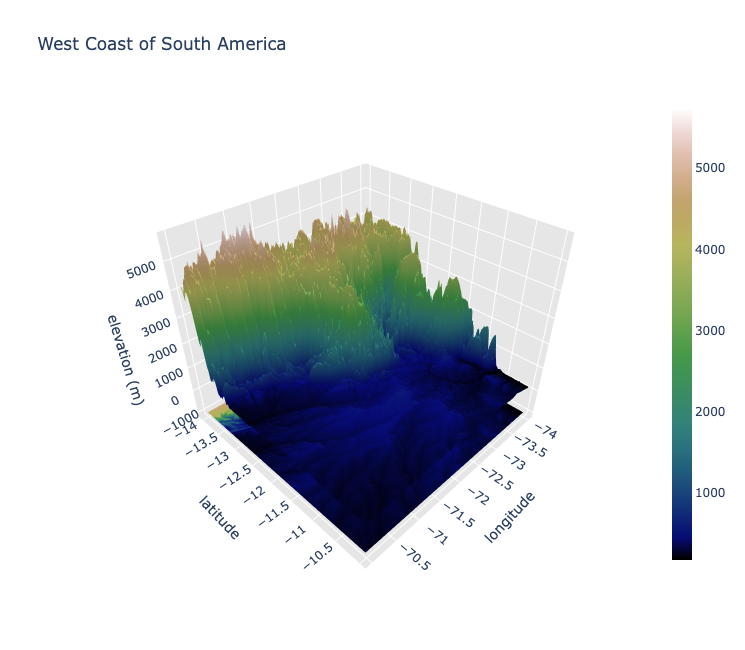

In [9]:
# The projection of the surface onto a plane parallel to the xOy plane 
# is implemented as a surface with the same x, y as in traceS,
# and z=z_offset defined below. This surface will be colored with the
# same colorscale, but not according to its height (which is constant 
# and equal to -1000), but according to the z-values in the traceS,
# i.e. according to the elevation of the first surface:
z_offset=-1000.0*np.ones(x.shape) 
surfacecolorz=z
textz=[['x: '+'{:0.3f}'.format(x[i][j])+'<br>y: '+'{:0.3f}'.format(y[i][j])+'<br>z: '+
        '{:0.3f}'.format(z[i][j]) for j in range(z.shape[1])] for i in range(z.shape[0])]

tracez =dict(type='surface',
             z=z_offset, 
             x=x,
             y=y,
             colorscale=pl_gist_earth,
             showlegend=False,
             showscale=False,
             surfacecolor=surfacecolorz,
             text=textz,
             hoverinfo='text'
               )

axis_x = dict(showbackground=True, 
              backgroundcolor="rgb(230, 230,230)",
              gridcolor="rgb(255, 255, 255)",      
              zerolinecolor="rgb(255, 255, 255)",
              title="longitude"
              )

axis_y = dict(showbackground=True, 
              backgroundcolor="rgb(230, 230,230)",
              gridcolor="rgb(255, 255, 255)",      
              zerolinecolor="rgb(255, 255, 255)",
              title="latitude"
              )

axis_z = dict(showbackground=True, 
              backgroundcolor="rgb(230, 230,230)",
              gridcolor="rgb(255, 255, 255)",      
              zerolinecolor="rgb(255, 255, 255)",
              title="elevation (m)"
              )

layout = dict(title='West Coast of South America', 
              width=800,
              height=650,
              scene=dict(xaxis=axis_x,
                         yaxis=axis_y, 
                         zaxis=axis_z, 
                         aspectratio=dict(x=1,
                                          y=1,
                                          z=0.85
                                         )
                        )
           )

fig=dict(data=[traceS, tracez], layout=layout)
plotly.offline.iplot(fig)

### TO DO

**Question 1.1** Report the *local relief* of the Andes mountain range with reference to the adjoining low-lying areas in the interactive plot above. 

**Answer:**

<br><br/>
<br><br/>

**Question 1.2** A typical low-lying topographic feature around a mountain belt is the *foreland basin*, which can be used as the reference for values of local relief. Is the foreland basin of the Andes on the overriding or subducting plate? What about the Himalayas?

**Answer:**

<br><br/>
<br><br/>

**Question 1.2** Make a static plot (i.e. using matplotlib, modifying codes above) of the cross-sectional topography across the Himalayas. We know that the Himalayas are the tallest mountain range on Earth. Do the Himalayas also have higher *local relief*?

**Answer:**

<br><br/>
<br><br/>

**Local relief and Denudation rate**

As the mountains rise, they are subjected to erosion which eventually decreases the mountains' reliefs after they stop rising. The rate at which the relief decays is called "denudation rate." The figure below shows the denudation rate at Papua New Guinea and the large midlatitude basins.

<img src = "Images/Denudation_Rate.png" width = "90%" >

The denudation rate at a given setting linearly scales on the relief:

$$ \frac{dh}{dt} = -\alpha h $$

where $h$ is the local relief, and $\alpha$ depends on the setting. Let us look at data of denudation rate and local relief from three different settings - Papua New Guinea, mid-latitude basins and various river basins. Note that the above equation implies that the relief reduces from the initial relief as an exponential function of time.

In [10]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline

In [11]:
data_papua = pd.read_csv('Files/Denudation_Papua_New_Guinea.csv')
data_papua.columns

Index(['Height (m)', 'Average denudation rate (cm / 1000 yr)'], dtype='object')

In [12]:
data_midlat = pd.read_csv('Files/Denudation_MidLatitude.csv')
data_midlat.columns

Index(['River Basin', 'Location', 'Mean relief h (m)', 'Mean sine of slope',
       'Mean denudation rate d (mm / 1000 yrs)'],
      dtype='object')

In [13]:
data_basins = pd.read_csv('Files/Denudation_River_Basins.csv')
data_basins.columns

Index(['Basin', 'Mean Local Relief (m)',
       'Total denudation rate (mm / 1000 yr)'],
      dtype='object')

In [14]:
# combine 3 sets of data together
heights_all = pd.concat([data_papua['Height (m)'],
                         data_midlat['Mean relief h (m)'],
                         data_basins['Mean Local Relief (m)']],
                        ignore_index=True)
denudations_all = pd.concat([data_papua['Average denudation rate (cm / 1000 yr)'] * 1000/100,
                             data_midlat['Mean denudation rate d (mm / 1000 yrs)'],
                             data_basins['Total denudation rate (mm / 1000 yr)']],
                            ignore_index=True)
regions_all = pd.Series(['Papua New Guinea', 'Mid-latitude Basins', 'River Basins'])
regions_all = regions_all.repeat([data_papua['Height (m)'].size,
                                  data_midlat['Mean relief h (m)'].size,
                                  data_basins['Mean Local Relief (m)'].size]).reset_index()[0]

locations_all = pd.Series(['N/A']).repeat([data_papua['Height (m)'].size]).reset_index()[0]
locations_all = pd.concat([locations_all, 
                           data_midlat['River Basin'], 
                           data_basins['Basin']], 
                          ignore_index=True)

data_all = pd.DataFrame({'Local relief (m)': heights_all,
                         'Denudation rate (m / Ma)': denudations_all,
                         'Region': regions_all,
                         'Location': locations_all})

In [15]:
import plotly
import plotly.graph_objects as go
import plotly.express as px
plotly.offline.init_notebook_mode() 

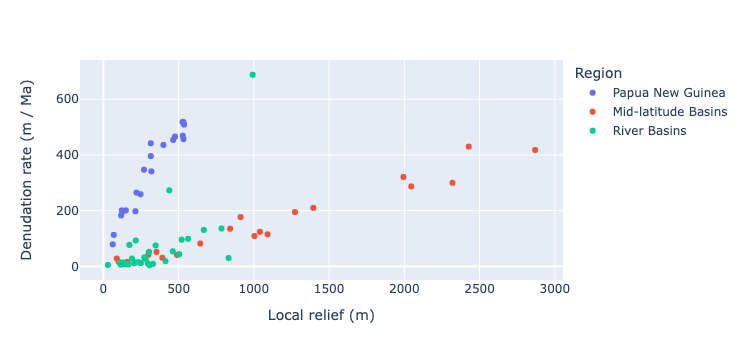

In [16]:
fig_1 = px.scatter(data_all, x='Local relief (m)', y='Denudation rate (m / Ma)', 
                   color='Region', hover_data=['Location'])
fig = go.Figure(data=fig_1,layout=fig_1.layout)
plotly.offline.iplot(fig)

### TO DO

**Question 2.1** Based on the interactive plot above, (A) Name two *outliers* that deviate strongly from the trend (*Hint*: Follow the dots that are of the same color), (B) describe how the denudation rates vary with tectonic settings. Do you expect rates to vary depending on rock type?

**Answer:**

<br><br/>
<br><br/>

**Question 2.2** Calculate $\alpha$ for the three settings: Papua New Guinea, Mid-Latitude basins, and River basins by fitting straight lines on the data from `Files/Denudation_Papua_New_Guinea.csv`, `Files/Denudation_MidLatitude.csv` and `Files/Denudation_River_Basins.csv`.  Note that the unit of $\alpha$ is the same as denudation rate / height. By unit conversion, the unit of mm/1000 yr/m is equivalent to m/1000000 yr/m or Ma$^{-1}$.

$$ \frac{mm / kyr}{m} = \frac{mm / kyr}{m} \times \frac{1 m}{1000 mm} \times \frac{1000 kyr}{1 Ma} = \frac{1}{Ma} $$

Below is how to fit a straight line $y = mx + c$ using  `numpy.polyfit`

    p = np.polyfit(x, y, 1)
    
    # y-value of the best-fitted line
    y_fit = p[0] * x + p[1]

**Answer**

<br><br/>
<br><br/>

**Question 2.3** Plot the percent of initial relief as a function of time in millions of years for the three settings. *Hint:* Use the function $ \frac{dh}{dt} = -\alpha h $

**Answer:**

<br><br/>
<br><br/>

**Denudation rate and erosion**

Since the top of the mountain is eroded away, the lithosphere block moves up due to the isostatic adjustment. As a result, the actual denudation rate is smaller than the denudation rate from the erosion only.

Let $h_a$ and $h_b$ is the thickness of the lithosphere above and below the mean sea level, respectively. Then, the total thickness $h$ is the sum of $h_a$ and $h_b$. In this case, $h_a$ refers to the *local relief*. Use density of crust $\rho_c = 2700 \text{kg/m}^3$ and density of mantle $\rho_m = 3300 \text{kg/m}^3$.

<img src = "Images/Isostasy.png" width = "70%" >

**Question 2.4** Modify the equation for denudation rate versus *local relief* to account for isostasy. Assume Pratt isostasy where the litosphere has the same constant density of $\rho_c$ floating on top of the asthenosphere with the density of $\rho_m$. *Hint:* View denudation as a change in total thickness of the lithosphere instead of just what you see above the surface.

**Answer**:

<br><br/>
<br><br/>

**Question 2.5** Under these conditions, how much time is required to denude a mountain belt from 1 km relief to 100 m relief for the three settings above?

**Answer:**

<br><br/>
<br><br/>

**Question 2.6** Given these mountain belts still exist, speculate on what factors prevent them from being denuded away by surface processes?

**Answer:**

<br><br/>
<br><br/>

## Part II: Seismic stations, seismographs, and seismograms


Seismographs are instruments at seismic stations that measure ground motion. The data is displayed as
seismograms. This data is of fundamental importance to the geosciences. By studying earthquake-generated ground motion we can learn about 1) the nature of the earthquake itself (the source of the motion) and 2) the material the earthquake waves travel through (Earth’s interior). This is because the observed vibration (in the time domain *t*) is the result of the effects of earthquake source, interior structure and how the instrument *senses* the vibration. These effects can be most easily modeled by considering each frequency ($\omega$) of the waveform in turn, and using their products (i.e. frequency-domain convolution per mathematical definition) to derive the waveform.

<img src = "Images/Convolution.png" width = "90%" >

*Figure: Relationship between measurement and contribution from instrument, structure and source.*



The United States Geologic Survey estimates that several million earthquakes occur each year. Many go
undetected because they hit remote areas without good seismic station coverage, or have very small
magnitudes. But various seismic networks locate something like 20,000 earthquakes a year. We will focus on two large earthquakes since they caused the whole Earth to ring like a bell, causing waveforms to be recorded at various stations well above the noise level of the instrument.

**Tohoku earthquake [USGS Link](https://earthquake.usgs.gov/earthquakes/eventpage/official20110311054624120_30/executive)**

The March 11, 2011, M 9.1 Tohoku earthquake, which occurred near the northeast coast of Honshu, Japan, on the subduction zone plate boundary between the Pacific and North America plates. The location, depth (about 25 km), and focal mechanism solutions of the March 11th earthquake are consistent with the event having occurred on the subduction zone plate boundary. Modeling of the rupture of this earthquake indicates that the fault moved as much as 50–60 m, and slipped over an area approximately 400 km long (along strike) by 150 km wide (in the down-dip direction). The Japan Trench subduction zone has hosted nine events of $m_w$ 7+ since 1973. 

### Mini-tutorial

 - **Reading the CMT solution file for an earthquake**
 
 
The focal mechanisms that are usually given to convey this configuration are a way of plotting the three dimensional fault information in two dimensions (they’re lower hemisphere [stereographic projections](http://mathworld.wolfram.com/StereographicProjection.html)). The figure below is an attempt to show how a simple block model of the first motions of 5 common types of earthquake look when projected onto a lower hemisphere, and then when the pattern on that focal sphere is projected onto the horizontal to produce a 2D focal mechanism.

<img src = "Images/focalmechs.png" width = "40%" >

*Figure: Types of faulting and their expression as focal mechanism of the earthquake.*

The [Global Centroid-Moment-Tensor (CMT) Project](https://www.globalcmt.org) has measured the moment tensors of all earthquakes with magntiudes $m_w$ 5.5+ since 1976. The CMT project has been continuously funded by the National Science Foundation since its inception. Let us read the CMT solution of the Tohoku earthquake in the *CMTSOLUTION* format, available from their webpage.

In [21]:
import numpy as np
import os
import subprocess
from multiprocessing import Pool
import glob
import errno
import cmath
from math import atan2
import pandas as pd
import pdb
from obspy import UTCDateTime,read_events,read,read_inventory
from obspy.geodetics import gps2dist_azimuth

#########################################################

def readcmtsolution(file='CMTSOLUTION'):
    if not os.path.isfile(file): raise FileNotFoundError(errno.ENOENT, os.strerror(errno.ENOENT), file)
    cmt={}
    f = open(file,'r')
    line=f.readline().split()
    cmt['source']=line[0];cmt['iyr']=int(line[1]);cmt['imo']=int(line[2]);cmt['ida']=int(line[3])
    cmt['iho']=int(line[4]);cmt['imi']=int(line[5]);cmt['fsec']=float(line[6]);cmt['eplat']=float(line[7]
)
    cmt['eplong']=float(line[8]);cmt['depth']=float(line[9]);cmt['mb']=float(line[10]);cmt['ms']=float(line[11])
    cmt['region']=' '.join(line[12:])

    cmt['ityphdur']=2
    cmt['itypso']=0
    cmt['time'] = UTCDateTime(cmt['iyr'],cmt['imo'],cmt['ida'],cmt['iho'],cmt['imi'],cmt['fsec'])

    # read cmts
    xm = np.zeros(6)
    while line:
        line = f.readline()
        if line[0:10] == 'event name':
            cmt['name']=line[12:].split()[0]
        elif line[0:10] == 'time shift':
            cmt['tcmt']=float(line[12:].split()[0])
        elif line[0:13] == 'half duration':
            cmt['hdur']=float(line[15:].split()[0])
        elif line[0:8] == 'latitude':
            cmt['epla']=float(line[10:].split()[0])
        elif line[0:9] == 'longitude':
            cmt['eplo']=float(line[11:].split()[0])
        elif line[0:5] == 'depth':
            cmt['depth']=float(line[7:].split()[0])
        #Double  couple
        elif line[0:3] == 'Mrr':
            xm[0]=float(line[5:].split()[0])
        elif line[0:3] == 'Mtt':
            xm[1]=float(line[5:].split()[0])
        elif line[0:3] == 'Mpp':
            xm[2]=float(line[5:].split()[0])
        elif line[0:3] == 'Mrt':
            xm[3]=float(line[5:].split()[0])
        elif line[0:3] == 'Mrp':
            xm[4]=float(line[5:].split()[0])
        elif line[0:3] == 'Mtp':
            xm[5]=float(line[5:].split()[0])
        # Single force
        elif line[0:3] == 'CFr':
            cmt['itypso']=1
            xm[1]=float(line[5:].split()[0])
        elif line[0:3] == 'CFt':
            cmt['itypso']=1
            xm[2]=float(line[5:].split()[0])
        elif line[0:3] == 'CFp':
            cmt['itypso']=1
            xm[3]=float(line[5:].split()[0])
        # Single force
        elif line[0:3] == 'SFr':
            cmt['itypso']=2
            xm[1]=float(line[5:].split()[0])
        elif line[0:3] == 'SFt':
            cmt['itypso']=2
            xm[2]=float(line[5:].split()[0])
        elif line[0:3] == 'SFp':
            cmt['itypso']=2
            xm[3]=float(line[5:].split()[0])

    if cmt['itypso'] > 1:
        xm[3]=0.
        xm[4]=0.
        xm[5]=0.
    cmt['xm']=xm
    
    # Moment tensor
    M = np.array([[xm[0], xm[3], xm[4]], [xm[3], xm[1], xm[5]], [xm[4], xm[5], xm[2]]])
    
    # Scalar moment
    M0 = np.sqrt(np.sum(M ** 2) / 2)
    cmt['m0'] = M0
    
    # Moment magnitude
    Mw = np.round(np.log10(M0) / 1.5 - 10.73, 1)
    cmt['mw'] = Mw

    return cmt

In [22]:
# read the CMT solution file of Tohoku earthquake
cmt = readcmtsolution('Files/CMTSOLUTION_TOHOKU')
print(cmt)

{'source': 'PDEW', 'iyr': 2011, 'imo': 3, 'ida': 11, 'iho': 5, 'imi': 46, 'fsec': 24.68, 'eplat': 38.32, 'eplong': 142.351, 'depth': 20.0, 'mb': 7.2, 'ms': 9.0, 'region': 'TOHOKU', 'ityphdur': 2, 'itypso': 0, 'time': UTCDateTime(2011, 3, 11, 5, 46, 24, 680000), 'name': '201103110546A', 'tcmt': 69.76, 'hdur': 70.0, 'epla': 37.52, 'eplo': 143.05, 'xm': array([  1.73000000e+29,  -2.81000000e+28,  -1.45000000e+29,
         2.12000000e+29,   4.55000000e+29,  -6.57000000e+28]), 'm0': 5.3118480305822004e+29, 'mw': 9.0999999999999996}


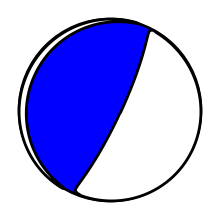

In [23]:
from obspy.imaging.beachball import beachball
fig = beachball(cmt['xm'])

### TO DO

**Question 3.1** Based on the beachball focal mechanism above, what type of faulting caused the Tohoku earthquake? Was the fault shallow or steeply dipping? Which plate was the overriding plate?

**Answer:**

<br><br/>
<br><br/>

### Section A: Signal processing of vibrations at a single station

Modern seismometers measure ground motion in three mutually perpendicular directions:

- *North-South* (LHN or BHN component). This records the north-south horizontal component of vibration.  “Up” on this graph means the ground moved north.  “Down” on this graph means the ground moved south.

- *East-West* (LHE or BHE component). This records the east-west horizontal component of vibration.  “Up” on this graph means the ground moved east.  “Down” on this graph means the ground moved west.

- *Vertical* (LHZ or BHZ component). This records the vertical component of vibration.  “Up” on this graph the means the ground moved up.  “Down” on this graph means the ground moved down. 

The prefix (L-long period, or B-broadband) indicates the sampling rate of seismic data stream. When we wish to analyse signals that are finely spaced, we use the broadband data steam (i.e. think of Nyquist frequency). Sometimes, the horizontal orientations of the sensor in the instrument are not perfectly aligned with the N-S and E-W directions, even if the vertical component is perfectly aligned. In these cases, the horizontal components are denoted as LH1 and LH2 (or BH1 and BH2). We typically analyze the motion along the propagation direction of the wavefront, which gives us clearer information on individual seismic phases (as you will see below). Note that finding the propagation direction from earthquake to a station requires the coordinates and depth of the hypocenter, as denoted by the CMT focal mechanism above. 

<img src = "Images/zrt.png" width = "45%" >

*Figure: Rotation of vibrations recorded on a seismogram to radial, transverse and vertical components along the propagation direction.*


Let us perform this calculation for the vibrations recorded on the long-period components at Ascension Island (station code: ASCN) in the South Atlantic Ocean from the Tohoku earthquake.

In [24]:
st = read('Files/waveforms/II.ASCN.*.LH*.mseed') # Ascension Island, distance=144
print(st)

3 Trace(s) in Stream:
II.ASCN.00.LH1 | 2011-03-11T05:46:25.069500Z - 2011-03-11T15:46:24.069500Z | 1.0 Hz, 36000 samples
II.ASCN.00.LH2 | 2011-03-11T05:46:25.069500Z - 2011-03-11T15:46:24.069500Z | 1.0 Hz, 36000 samples
II.ASCN.00.LHZ | 2011-03-11T05:46:25.069500Z - 2011-03-11T15:46:24.069500Z | 1.0 Hz, 36000 samples


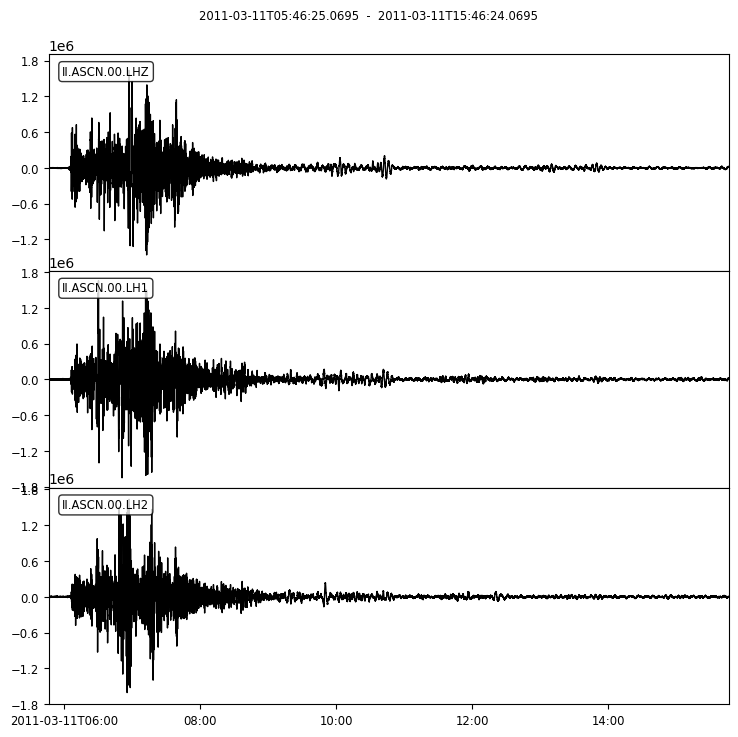

In [25]:
st.plot();

We want to convert from counts (e.g. voltage) reported by the seismometer above to ground dispacement (or velocity or accelaration), which is the value we are interested in. This is done by considering the instrument response of the instrument. For this station (ASCN), the response belows shows that all vibrations at periods roughly 1-3000 seconds will be recorded with enough amplitude counts.

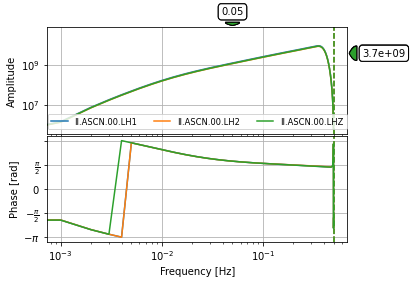

In [26]:
stationdir = 'Files/stations/'
inv = read_inventory('%s%s.%s.xml' % (stationdir, st[0].stats.network, st[0].stats.station))
inv.plot_response(0.001, output="DISP");

We also wish to focus on vibrations in the period range 20-200 seconds to start with. This done by *band-pass filtering* the seismogram below:

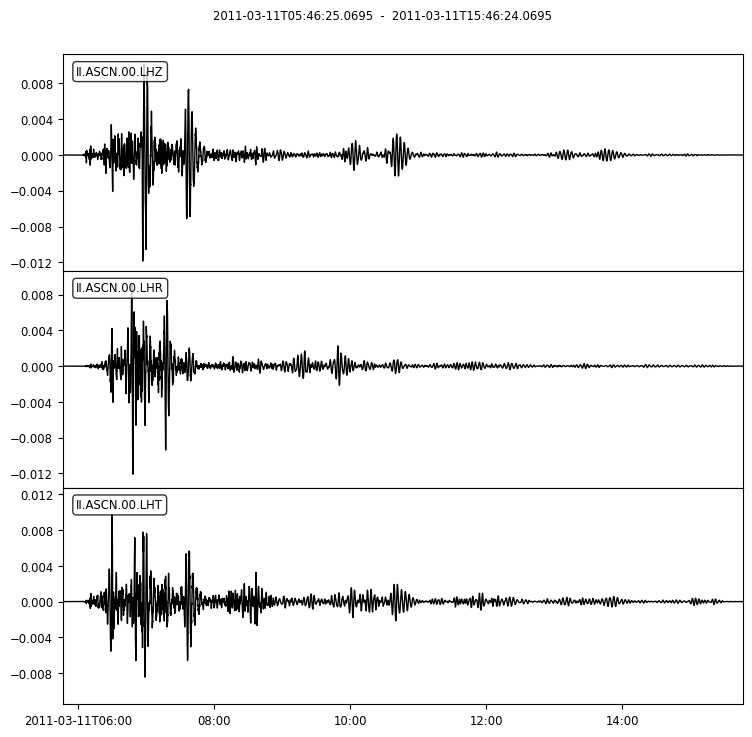

In [27]:

periods = [20,200]

stat_lat = inv.select(station=st[0].stats.station)[0][0].latitude
stat_lon = inv.select(station=st[0].stats.station)[0][0].longitude
evt_lat = cmt['epla']
evt_lon = cmt['eplo']

# compute back azimuth (check sign, later!):
dist, back_az, az = gps2dist_azimuth(evt_lat, evt_lon, stat_lat, stat_lon)

# convert distance to degrees
dist = (dist / 6371000) / np.pi * 180

# select the traces from a station
st3 = st.copy()

# remove instrument response, filter, and rotate
pre_filt = [0.8/periods[1] ,1/periods[1], 1/periods[0], 1.25/periods[0]]
st3 = st3.remove_response(inventory=inv, output="DISP",pre_filt=pre_filt).taper(0.05)
if not st3.select(channel='LHE'): st3 = st3.rotate(method="->ZNE", inventory=inv,back_azimuth=back_az)
st3 = st3.rotate(method="NE->RT", inventory=inv,back_azimuth=back_az)
st3.plot();

In [28]:
import holoviews as hv
from holoviews.operation.datashader import datashade
from holoviews.streams import PlotSize
import datashader as ds
from holoviews import opts
PlotSize.scale=2
hv.extension('plotly')

import plotly
import plotly.graph_objects as go
import plotly.express as px
plotly.offline.init_notebook_mode() 

from obspy.taup import TauPyModel
from obspy.geodetics.base import gps2dist_azimuth
import warnings
warnings.filterwarnings("ignore")

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

### Section B: Horizontal versus Vertical Motions

#### Task I: At a single station

In [29]:
duration_h = 1.5
st3 = st3.slice(endtime=st3[0].stats.starttime + 3600*duration_h)

# grab the time series data for processing
scalefactor = 0.5
times = np.array([])
signals = np.array([])
component_indicator = []
components = ["T", "Z"]
for ii, component in enumerate(components):
    trace = st3.select(component=component)[0]
    t = trace.times()
    x = trace.data
    x_scale = np.max(np.abs(x)) * scalefactor
    times = np.hstack((times, t/60))       # convert to minutes
    signals = np.hstack((signals, 2*ii + x / x_scale))
    component_indicator += [component] * t.size
        
# convert to dataframe
data = dict()
cols = []

data['time (minutes)'] = times 
data['signal (normalized)'] = signals
data['component'] = component_indicator
data['station'] = ['%s-%s' % (st3[0].stats.network, st3[0].stats.station)] * times.size
data['distance'] = [dist] * times.size
data['azimuth'] = [az] * times.size
dfm = pd.DataFrame(data)

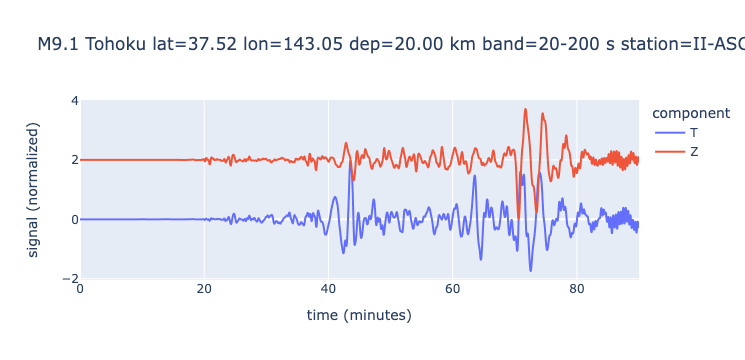

In [30]:
fig_title = 'M%.1f %s lat=%.2f lon=%.2f dep=%.2f km band=%d-%d s station=%s-%s' % (cmt['mw'], 
                                                                                   cmt['region'].capitalize(), 
                                                                                   cmt['epla'], 
                                                                                   cmt['eplo'], 
                                                                                   cmt['depth'],
                                                                                   periods[0], 
                                                                                   periods[1],
                                                                                   st3[0].stats.network,
                                                                                   st3[0].stats.station)
fig_1 = px.line(dfm, x='time (minutes)', y='signal (normalized)', color='component', 
                hover_data={'station': ':.s', 'distance': ':.2f', 'azimuth':':.2f'}, 
                title=fig_title)
fig = go.Figure(data=fig_1,layout=fig_1.layout)
plotly.offline.iplot(fig)

#### TO DO

**Question 3.2** Identify the first seismic wave arrival at your station on the Z component. This is the first P-wave.  Note that you should consider when the seismograph first starts to respond to the P-wave – i.e., the “shoulder” of the wave, or where trace starts to climb or fall towards the first peak or trough. Report your P-wave *travel time pick* in minutes and seconds.

**Answer:**

<br><br/>
<br><br/>

**Question 3.3** Identify the first S-wave arrival at your station.  Hint: how would the relative horizontal vs. vertical motion differ for an S wave compared to a P wave?   There may also be a change in wavelength and/or amplitude; S-waves look ‘different” than P-waves. 
But there is likely more uncertainty about when to “pick” the arrival time of the first S-wave. This is because by this time, the station is still responding to the passage of P and other waves; and the S-waves are superimposed on these other waves.  This is part of the “art” of seismology – and also partly why we use data from many stations to analyze seismic waves. Report your S-wave *travel time pick* in minutes and seconds.

**Answer:**

<br><br/>
<br><br/>

**Question 3.4** Identify the surface waves on the seismogram. These are the waves with the strongest vibrations (largest ampolitudes). Provide your *travel time picks* for the Rayleigh and Love wave packets on Z and T components, respectively. *Note*: Picking a travel time of a surface wave is complicated an depends strongly on the frequency of the surface wave, due to a property called *dispersion*. For this task, simply report the time of the first shoulder from the left (earliest in time). Which of the two waves (Love or Rayleigh) is arriving sooner at the station?

**Answer:**

<br><br/>
<br><br/>

#### Task II: Record Section of the USArray Transportable Array

A single seismometer can give us some information about the earthquake and interior structure. In fact, this is the idea behind deploying a seismometer on the Moon and Mars. However, *arrays* of seismometer can provide unprecedented insights into geological processes.  

[USArray](http://www.usarray.org) is a 15-year program to place a dense network of permanent and portable seismographs across the continental United States. The seismographs record local, regional, and distant (teleseismic) earthquakes. This mega-project is funded by the US National Science Foundation and we will use data from a part of this project called the *Transportable Array*.


<img src = "Images/Install_plan_2014.png" width = "70%" >

*Figure: Installation plan of the transportable array of USArray.*

USArray has a large traveling network of 400 high-quality, portable seismographs that are being placed in temporary sites across the United States in a rolling fashion. Station spacing is ~70 km (42 mi). Transportable Array data are extremely useful for mapping the structure of Earth's uppermost 70 km. The array was initially deployed in the westernmost United States. Unless adopted and made into a permanent installation, after 18-24 months, each instrument is picked up and moved to the next carefully spaced array location to the east. When completed, over 2000 locations will have been occupied during this program.

Note that since we are looking at the data from Tohoku earthquake in 2011, we are using data from the Transportable Array as it was installed at that time. This means the stations that we are analyzing lie on a grid from Michigan to Louisiana.


In [31]:
from scipy import interpolate

def plottraces(cmt, 
               st, 
               stationdir, 
               periods=[20,100],
               component="T", 
               phaselist=["P", "S", "PcP", "ScS"],
               plottype="holoviews",
               duration_h=1.0,
               scalefactor=1.0):
    '''
    Make holoview objects for plotting traces against epicentral distance
    
    Input:
    -----
    cmt:            CMT Solution
    st:             Obspy stream object containing 3 components seismograms
    stationdir:     directory to station XML files for the streams
    periods:        [min, max] periods for bandpass filter
    phaselist:      list of phases to be plotted
    plottype:       either "holoviews" or "datashader"
    duration:       the number of hours of seismograms to be plotted
    scalefactor:    factor to reduce the amplitude of the seismogram
    
    Output:
    ------
    overlay_trace:  holoview object for trace plots
    overlay_phase:  holoview object for phase plots
    options:        options used by datashader
    
    These outputs will be used in the next command to create a plot:
    ---------------------------------------------------------------
    datashade(ndoverlay * overlay_phase, cmap=["black"], cnorm='linear', 
              aggregator=ds.count(), line_width=8).opts(opts)
    
    '''
        
    ########################################################
    # READ, PREOCESS, AND GATHER TRACES
    ########################################################
    signals = []
    dists = []

    # set the time for all trace to be the same
    t_trace = st[0].slice(endtime=st[0].stats.starttime + 3600*duration_h).times()

    for tr in st.select(channel='LHZ'):
        inv = read_inventory('%s%s.%s.xml' % (stationdir, tr.stats.network, tr.stats.station))
        stat_lat = inv.select(station=tr.stats.station)[0][0].latitude
        stat_lon = inv.select(station=tr.stats.station)[0][0].longitude
        evt_lat = cmt['epla']
        evt_lon = cmt['eplo']

        # compute back azimuth (check sign, later!):
        dist, back_az, _ = gps2dist_azimuth(evt_lat, evt_lon, stat_lat, stat_lon)

        # convert distance to degrees
        dist = (dist / 6371000) / np.pi * 180
        dists += [dist]

        # select the traces from a station
        st3 = st.select(station=tr.stats.station).copy()

        # remove instrument response, filter, and rotate
        pre_filt = [0.8/periods[1] ,1/periods[1], 1/periods[0], 1.25/periods[0]]
        st3 = st3.slice(endtime=st3[0].stats.starttime + 3600*duration_h).remove_response(inventory=inv, 
                            output="DISP",pre_filt=pre_filt).taper(0.05)
        if not st3.select(channel='LHE'):
            st3 = st3.rotate(method="->ZNE", inventory=inv,back_azimuth=back_az)
        st3 = st3.rotate(method="NE->RT", inventory=inv,back_azimuth=back_az)

        # grab the time series data for processing
        trace = st3.select(component=component)[0]
        t = trace.times()
        x = trace.data

        # interpolate to the same time
        f = interpolate.interp1d(t, x, kind='linear', fill_value='extrapolate')
        x = f(t_trace)
        x_scale = np.max(np.abs(x)) * scalefactor
        signals += [dist + x / x_scale]
        
        
    # convert to dataframe
    data = dict()
    cols = []

    for ii in range(len(signals)):
        data["trace_%03d" % ii] = signals[ii]
        cols += ["trace_%03d" % ii]
    data['time'] = t / 60                                 # convert to minutes
    dfm = pd.DataFrame(data)
        
    ########################################################
    # CALCULATE TRAVEL TIMES
    ########################################################
    dist_min = np.min(dists)
    dist_max = np.max(dists)

    distances = np.arange(np.floor(dist_min), np.ceil(dist_max) + 1, 0.5)
    traveltime_phases = np.ones((np.size(distances), len(phaselist))) * np.nan

    model = TauPyModel(model="ak135")
    for ii, dist in enumerate(distances):
        for jj, phase in enumerate(phaselist):
            arrivals = model.get_travel_times(source_depth_in_km=cmt['depth'],
                                              distance_in_degree=dist,
                                              phase_list=[phase])
            if arrivals:
                traveltime_phases[ii, jj] = arrivals[0].time
                
    # convert to dataframe
    traveltime = dict()
    for jj, phase in enumerate(phaselist):
        traveltime[phase] = traveltime_phases[:,jj] / 60  # convert to minutes
    traveltime['distance'] = distances
    dft = pd.DataFrame(traveltime)
    
    ########################################################
    # PLOT
    ########################################################
    options = hv.opts.RGB(width=800, height=800, xlabel='Time (minutes)', 
                       title='M%.1f %s lat=%.2f lon=%.2f dep=%.2f km comp=%s band=%d-%d s, phase=%s' % (cmt['mw'], 
                                                                                                        cmt['region'].capitalize(), 
                                                                                                        cmt['epla'], 
                                                                                                        cmt['eplo'], 
                                                                                                        cmt['depth'], 
                                                                                                        component, 
                                                                                                        periods[0], 
                                                                                                        periods[1],
                                                                                                        phaselist))
    
    
    if plottype == "datashader":
        overlay_trace = hv.NdOverlay({c:hv.Curve((dfm['time'], dfm[c]), vdims = ['Distance (degree)'], label='trace') for c in cols})
        if len(phaselist) > 0: 
            overlay_phase = hv.NdOverlay({phase:hv.Curve((dft[phase], dft['distance']), 
                                                     vdims = ['Distance (degree)']
                                                     #label = phase
                                                    ) for phase in phaselist})
            # Make the phase curve thicker
            overlay_phase = overlay_phase * overlay_phase * overlay_phase * overlay_phase
        else:
            overlay_phase=None
    else:
        overlay_trace = [hv.Curve((dfm['time'], dfm[c]), vdims = ['Distance (degree)'], group='trace') for c in cols]
        if len(phaselist) > 0: 
            overlay_phase = [hv.Curve((dft[phase], dft['distance']), vdims = ['Distance (degree)'], group = 'phase') for phase in phaselist]
        else:
            overlay_phase=None
    
    return overlay_trace, overlay_phase, options

In [32]:
# read waveforms recorded by US Transportable Array
st = read('Files/waveforms/TA.*.LH*.mseed')

:DynamicMap   []
   :RGB   [x,Distance (degree)]   (R,G,B,A)
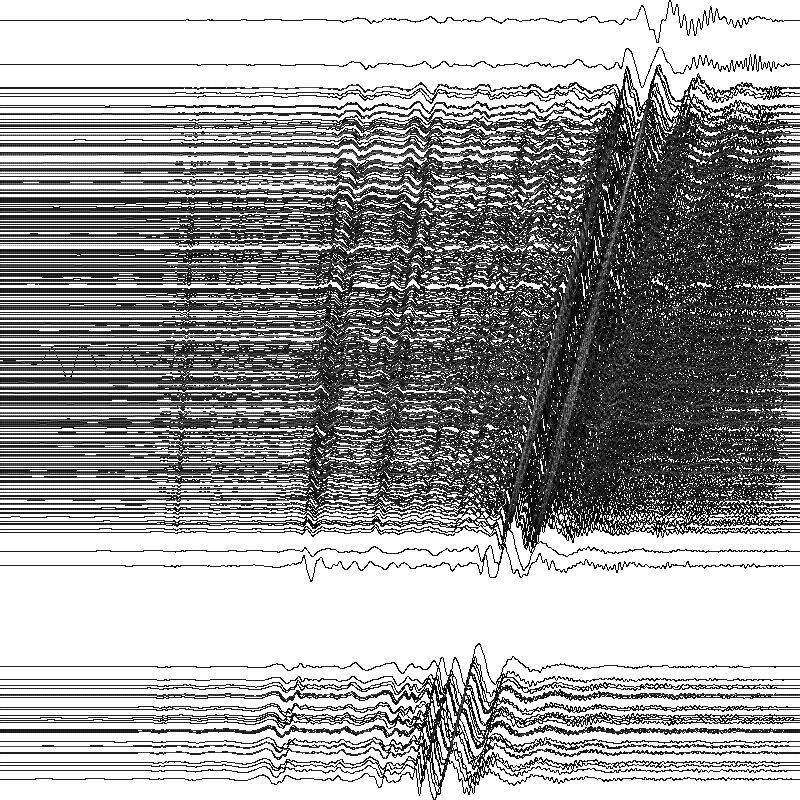

In [33]:
#overlay_trace, overlay_phase, options = plottraces(cmt, st, 'Files/stations/', [20,200], "Z", ["S", "pP", "P","PP"], "datashader")
overlay_trace, overlay_phase, options = plottraces(cmt, st, 'Files/stations/', [20,200], "Z", [], "datashader")
if overlay_phase != None:
    things_to_plot = overlay_trace * overlay_phase
else:
    things_to_plot = overlay_trace 
datashade(things_to_plot, cmap="gist_gray", cnorm='linear', aggregator=ds.count()).opts(options)

:DynamicMap   []
   :RGB   [x,Distance (degree)]   (R,G,B,A)
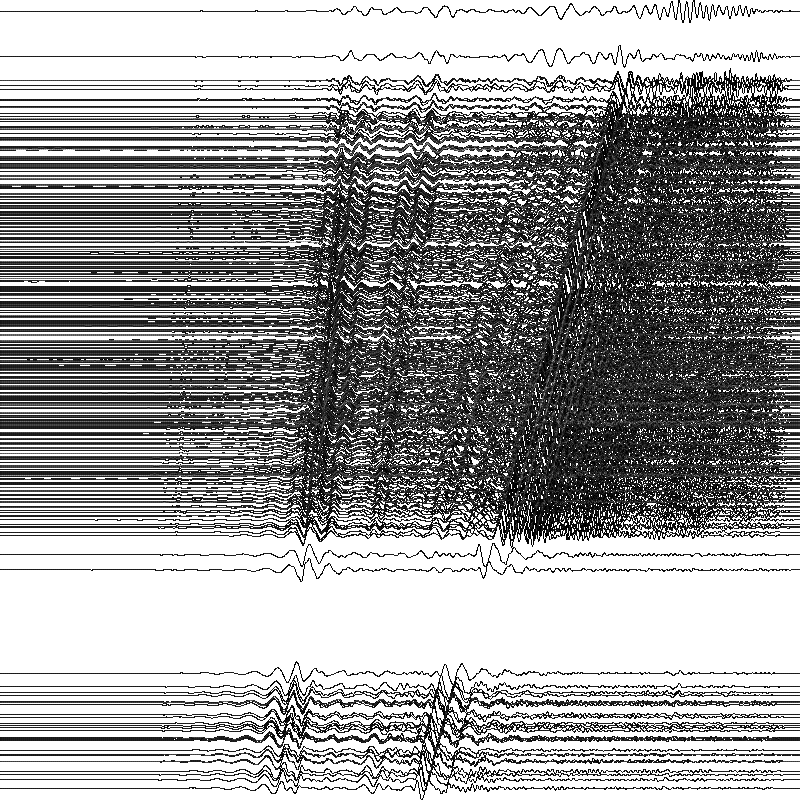

In [34]:
#overlay_trace, overlay_phase, options = plottraces(cmt, st, 'Files/stations/', [20,100], "T", ["S", "ScS"], "datashader", 1, 2)
overlay_trace, overlay_phase, options = plottraces(cmt, st, 'Files/stations/', [20,100], "T", [], "datashader", 1, 2)
if overlay_phase != None:
    things_to_plot = overlay_trace * overlay_phase
else:
    things_to_plot = overlay_trace 
datashade(things_to_plot, cmap="gist_gray", cnorm='linear', aggregator=ds.count()).opts(options)

#### TO DO

**Question 3.5** The *record sections* above show data from the first hour after the earquake origin time on the Z and T components. Zoom into a any distance range 10 degrees in width, and download the image as png from the options (top right). Draw a line with a red pen where you see the P wave (on the Z component) and S wave (on the T component). Find slope of this curve oand report this as the speed of the P and S wave (in m/s). Are the slopes expected to vary with distance? If so, why? *Hint:* You can assume that 1 degree equals 111.1949 km on average. Attach the annotated image with the assignment.

**Answer:**

<br><br/>
<br><br/>

### Part 2: Waveforms at different period bands

Next, we will evaluate if we can glean more information by analyzing waveforms at other period bands. As you will see, there is a plethora of information in these seismograms at various period/frequency bands. Let us look at the vertical (Z) component from the US Transportable Array at two period bands (5-40 seconds vs 20-100 seconds).

:DynamicMap   []
   :RGB   [x,Distance (degree)]   (R,G,B,A)
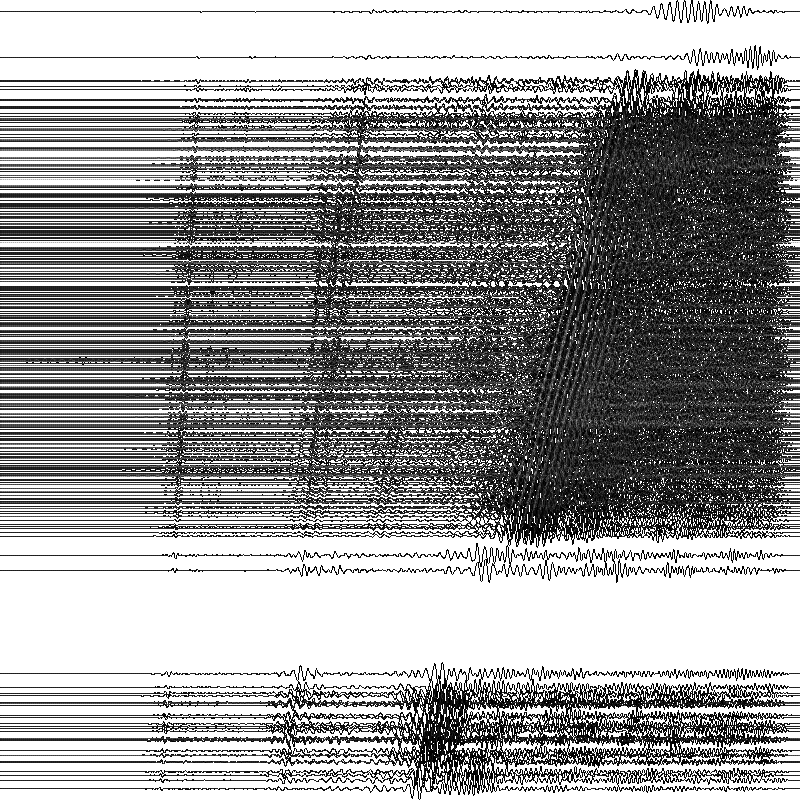

In [35]:
overlay_trace, overlay_phase, options = plottraces(cmt, st, 'Files/stations/', [5,40], "Z", [], "datashader", 1, 2)
if overlay_phase != None:
    things_to_plot = overlay_trace * overlay_phase
else:
    things_to_plot = overlay_trace 
datashade(things_to_plot, cmap="gist_gray", cnorm='linear', aggregator=ds.count()).opts(options)

:DynamicMap   []
   :RGB   [x,Distance (degree)]   (R,G,B,A)
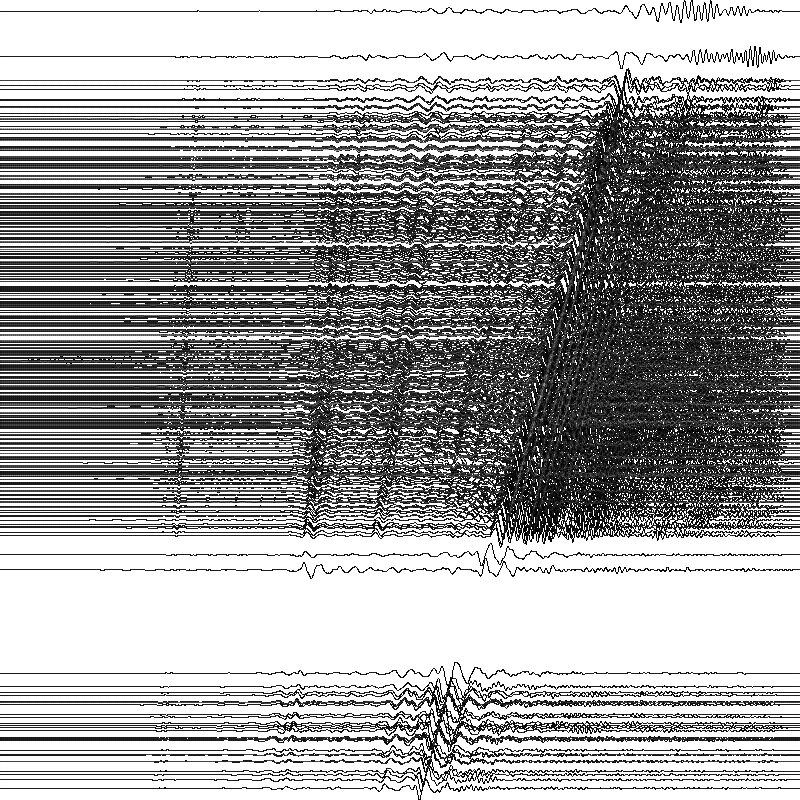

In [36]:
overlay_trace, overlay_phase, options = plottraces(cmt, st, 'Files/stations/', [20,100], "Z", [], "datashader", 1, 2)
if overlay_phase != None:
    things_to_plot = overlay_trace * overlay_phase
else:
    things_to_plot = overlay_trace 
datashade(things_to_plot, cmap="gist_gray", cnorm='linear', aggregator=ds.count()).opts(options)

#### TO DO

**Question 3.6** The *record sections* above show data from the first hour after the earquake origin time on the Z component for data filtered at two period bands (5-40 seconds vs 20-100 seconds). Do you see any phases that are more prominent in one period band or the other? Annotate this phase by zooming into any distance range 10 degrees in width, and downloading the image as png from the options (top right). Attach the annotated image with the assignment.

**Answer:**

<br><br/>
<br><br/>

### Part 3: Spectrum of Vibrations



#### Mini-tutorial

- Primer in Fourier transforms


A Fourier transform (FT) is a mathematical transform that decomposes functions into frequency components, which are represented by the output of the transform as a function of frequency. Most commonly functions of time or space are transformed, which will output a function depending on temporal frequency or spatial frequency respectively. 

In [37]:
%matplotlib inline

from scipy.fftpack import fft
import numpy as np
from importlib import reload
import os
from scipy import signal
import matplotlib.pyplot as plt


The Fourier transform takes a signal from the time into the frequency domain. One application of the Fourier transform is that we can recover the amplitudes and frequencies of a sampled signal.
We will use the package numpy.fft. The underlying code for these functions is an f2c-translated and
modified version of the FFTPACK routines. FFTPACK is a package of Fortran subprograms for the fast
Fourier transform of periodic and other symmetric sequences. It includes complex, real, sine, cosine, and quarter-wave transforms.

For example, consider the signal 2 · cos(4 · 2πt) + 5 · sin(10 · 2πt) composed of a cosine with amplitude 2, frequency 4, and a sine with amplitude 5 and frequency 10. Using rfft of the package numpy.fft, the script below computes the discrete Fourier transform on the real array of samples via the efficient Fast Fourier Transform algorithm. We recover the amplitudes and corresponding frequencies of the components of our signal. With matplotlib we plot the spectrum.

2.0*cos(4*2*pi*t)
5.0*sin(10*2*pi*t)


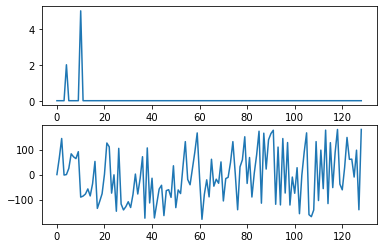

In [38]:
f = lambda t: 2*np.cos(4*2*np.pi*t) + 5*np.sin(10*2*np.pi*t)
n = 256
r = np.arange(0.0,1.0,1.0/n)
s = f(r)
F = np.fft.rfft(s)
m = n/2
p = lambda z: (abs(np.real(z))/m,abs(np.imag(z))/m)
t = p(F)
tol = 1.0e-8
for i in range(0,len(t[0])):
    if(t[0][i] > tol):
        print(str(t[0][i]) + '*cos(' + str(i) + '*2*pi*t)')
    if(t[1][i] > tol):
        print(str(t[1][i]) + '*sin(' + str(i) + '*2*pi*t)')
fig = plt.figure()
plt.subplot(2, 1, 1)
plt.plot(abs(F)/m)
plt.subplot(2, 1, 2)
plt.plot(np.angle(F,deg=True))
plt.show()

To complete the illustration of time versus frequency plots (a normal signal versus it's spectrum), here is a seismic signal (ground motion caused by an earthquake). The time series is a complicated looking signal. In fact, this signal can be described as a combination of a very large number of sinusoids, all with amplitudes as shown in the spectrum graph.

**2004 Sumatra - Andaman Islands Earthquake [USGS Link](https://earthquake.usgs.gov/earthquakes/eventpage/official20041226005853450_30/executive)**

The devastating M 9.1 earthquake off the west coast of northern Sumatra on December 26, 2004, occurred as the result of thrust faulting on the interface of the India plate and the Burma microplate. In a period of minutes, the faulting released elastic strains that had accumulated for centuries from ongoing subduction of the India plate beneath the overriding Burma microplate. 

Since this earthquake was so large, it was able to *ring* the Earth like a bell, causing vibrational normal modes or standing waves. Let us look at the data from this earthquake recorded at Echery - Sainte Marie aux Mines, France.


In [39]:
from pathlib import Path
import numpy as np
import matplotlib.pyplot as plt
from obspy.clients.fdsn import Client
from obspy import UTCDateTime,read_inventory, read
from obspy.geodetics.base import gps2dist_azimuth
from gatspy.periodic import LombScargleFast

inventory_store = 'Files/ECH_inventory.xml'
path = Path(inventory_store)

if path.is_file():
    inv = read_inventory(inventory_store)
else:
    # Create two times which we will later use to download time series data.
    starttime = UTCDateTime(2004, 12, 26, 0, 58, 50)
    # Create a new time object by adding 10 days to the previous ones. Time
    # differences are in seconds.
    endtime = starttime + 86400 * 10
    client='IRIS'
    level='response'
    query ='G-ECH-*-LH*'

    c = Client(client)
    network,station,location,channel=query.split('-')
    inv = c.get_stations(network=network, station=station, location=location, channel=channel,
                     starttime=starttime, endtime=endtime,level=level)
    
    inv.write(inventory_store, format='STATIONXML')  

In [40]:
st = read('Files/Sumatra_2004_ECH.mseed')

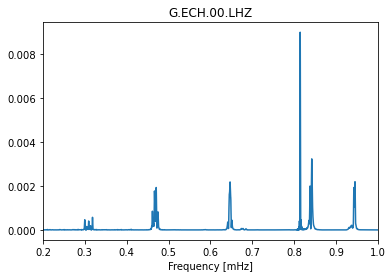

In [41]:
nhours = 230
pre_filt=[1e-4,2e-4,3e-3,4e-3]

# read stat_lon, stat_lat
stat_lon = inv[0][0].longitude
stat_lat = inv[0][0].latitude

# read evt_lat, evt_lon
evt_lat = 3.09
evt_lon = 94.26

# compute back azimuth (check sign, later!):
dist, back_az, _ = gps2dist_azimuth(evt_lat, evt_lon,stat_lat, stat_lon)        

st2 = st.copy().slice(endtime=st[0].stats.starttime + 3600*nhours).remove_response(inventory=inv, output="ACC",pre_filt=pre_filt).rotate(method="NE->RT", inventory=inv,back_azimuth=back_az).taper(0.05)

# Remember the copy()!
tr = st2.select(component="Z")[0]


fmin = 0.0001
fmax = 0.001
N = 10000000 # frequency resolution
df = (fmax - fmin) / N

time = np.linspace(start=0,stop=tr.stats.endtime-tr.stats.starttime,num=tr.stats.npts,endpoint=True)
model = LombScargleFast().fit(time, tr.data)
power = model.score_frequency_grid(fmin, df, N)
freqs = fmin + df * np.arange(N)

plt.plot(freqs*1000, power)
plt.xlim(0.2, 1.0)
plt.xlabel("Frequency [mHz]")
plt.title(tr.id)
plt.show()

#### TO DO

**Question 3.7** Report the approximate frequencies that you observe on the spectrum here. Identify atleast one normal mode and describe how it deforms the Earth.

**Answer:**

<br><br/>
<br><br/>

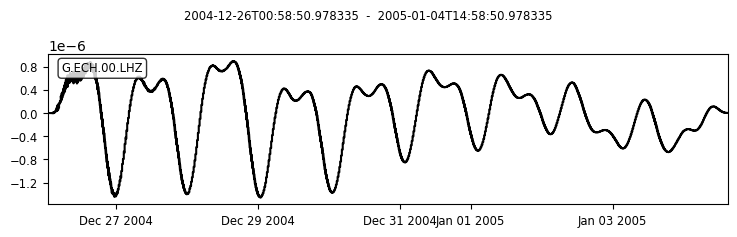

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


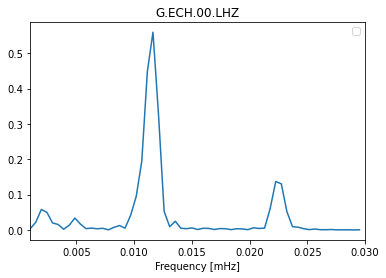

In [42]:
# LOOK AT TIDES
fmin = 0.001*1E-3
fmax = 0.03*1E-3

pre_filt=[1e-6,2e-6,3e-3,4e-3]
st2 = st.copy().slice(endtime=st[0].stats.starttime + 3600*nhours).remove_response(inventory=inv, 
                      output="ACC",pre_filt=pre_filt).rotate(method="NE->RT", 
                      inventory=inv,back_azimuth=back_az).taper(0.05)
tr = st2.select(component="Z")[0]
tr.plot()

N = 60 # frequency resolution
df = (fmax - fmin) / N

# Faster
time = np.linspace(start=0,stop=tr.stats.endtime-tr.stats.starttime,num=tr.stats.npts,endpoint=True)
model = LombScargleFast().fit(time, tr.data)
power = model.score_frequency_grid(fmin, df, N)
freqs = fmin + df * np.arange(N)

plt.plot(freqs*1000, power)
plt.xlim(fmin*1000, fmax*1000)
plt.legend()
plt.xlabel("Frequency [mHz]")
plt.title(tr.id)
plt.show()

#### TO DO

**Question 3.8** Seismometer are so sensitive that they also record vibrations due to tides in the solid Earth. An example is seen in the spectrum above. Report the two frequencies. Convert to minutes/hours and comment on the forces causing these longer period vibrations (compared to seismic waves).

**Answer:**

<br><br/>
<br><br/>